#### Import required packages  


24-nov
    - t-SNE followed by spectral clustering



<a name='toc'></a>  TOC

* <a href='#me.01.t1'> Modeling and Evaluation 1</a> :
            Train and adjust parameters  
            
  - <a href='#t-sne'> t-SNE</a>
  - <a href='#end_of_file'> end of file</a>


In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy

from pylab import rcParams
#import hdbscan

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

#### Read in cleaned  dataset from .csv file  

In [41]:
data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_03.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

#del df_cluster['data_channel']


# ... read in original data set to retreive 'shares' values


data_file = 'OnlineNewsPopularity.csv'

file_2_read = data_dir + data_file
df_ONP = pd.read_csv(file_2_read)

df_ONP.columns = df_ONP.columns.str.strip()

df_ONP = df_ONP[['shares']]

df_ONP['ln_shares'] = np.log(df_ONP['shares']+1)

df_ONP['popular'] = np.where(df_ONP['shares'] > 1400, True, False)


In [42]:
col_names = df_cluster.columns.values.tolist()
col_names

['n_tokens_title',
 'num_keywords',
 'data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_socmed',
 'kw_avg_max',
 'weekday_is_monday',
 'weekday_is_tuesday',
 'weekday_is_wednesday',
 'weekday_is_thursday',
 'weekday_is_friday',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares']

,count,mean,std,min,25%,50%,75%,max
n_tokens_title,39644.0,10.398749,2.114037,2.0,9.000000,10.000000,12.000000,23.000000
num_keywords,39644.0,7.223767,1.909130,1.0,6.000000,7.000000,9.000000,10.000000
data_channel_is_lifestyle,39644.0,0.052946,0.223929,0.0,0.000000,0.000000,0.000000,1.000000
data_channel_is_entertainment,39644.0,0.178009,0.382525,0.0,0.000000,0.000000,0.000000,1.000000
data_channel_is_socmed,39644.0,0.058597,0.234871,0.0,0.000000,0.000000,0.000000,1.000000
kw_avg_max,39644.0,1.913205,1.000000,0.0,1.271003,1.800325,2.442234,6.248298
weekday_is_monday,39644.0,0.168020,0.373889,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_tuesday,39644.0,0.186409,0.389441,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_wednesday,39644.0,0.187544,0.390353,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_thursday,39644.0,0.183306,0.386922,0.0,0.000000,0.000000,0.000000,1.000000


['n_tokens_title',
 'num_keywords',
 'data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_socmed',
 'kw_avg_max',
 'weekday_is_monday',
 'weekday_is_tuesday',
 'weekday_is_wednesday',
 'weekday_is_thursday',
 'weekday_is_friday',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares']

In [43]:
# set required variables for model comparison

comparison_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

<a href='#toc'> Table of Contents</a>

<a name='t-sne'></a>
<font color="blue" size=3> t-SNE

### t-SNE  


In [44]:
from sklearn.manifold import TSNE

X1 = df_cluster
X1['ln_shares'] = df_ONP['ln_shares']
X1['popular'] = df_ONP['popular']
                     
X1 = X1.sample(frac = 0.30)

X1_ln_shares = X1['ln_shares']
X1_popular = X1['popular']

columns_to_drop = ['ln_shares', 'popular']
X1.drop(columns_to_drop, axis = 1, inplace = True)

tic = time.clock()

tsne = TSNE(n_components = 2, verbose = 1, perplexity = 5, n_iter = 300)

tsne_results = tsne.fit_transform(X1)

toc = time.clock()
print (toc - tic)

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 11893 samples in 0.028s...
[t-SNE] Computed neighbors for 11893 samples in 6.274s...
[t-SNE] Computed conditional probabilities for sample 1000 / 11893
[t-SNE] Computed conditional probabilities for sample 2000 / 11893
[t-SNE] Computed conditional probabilities for sample 3000 / 11893
[t-SNE] Computed conditional probabilities for sample 4000 / 11893
[t-SNE] Computed conditional probabilities for sample 5000 / 11893
[t-SNE] Computed conditional probabilities for sample 6000 / 11893
[t-SNE] Computed conditional probabilities for sample 7000 / 11893
[t-SNE] Computed conditional probabilities for sample 8000 / 11893
[t-SNE] Computed conditional probabilities for sample 9000 / 11893
[t-SNE] Computed conditional probabilities for sample 10000 / 11893
[t-SNE] Computed conditional probabilities for sample 11000 / 11893
[t-SNE] Computed conditional probabilities for sample 11893 / 11893
[t-SNE] Mean sigma: 0.739581
[t-SNE] KL divergence

/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


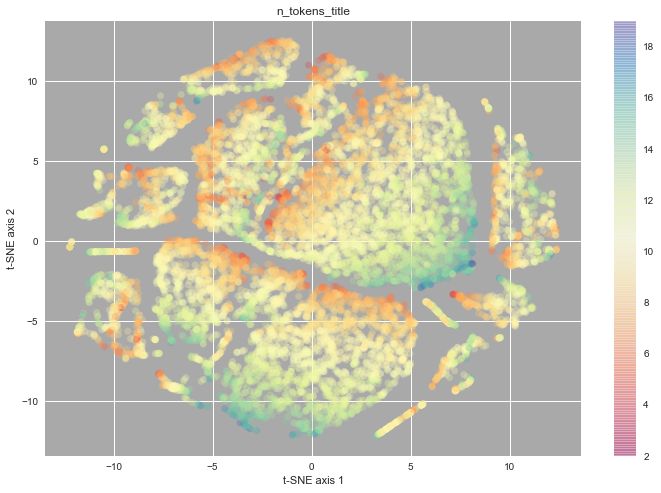

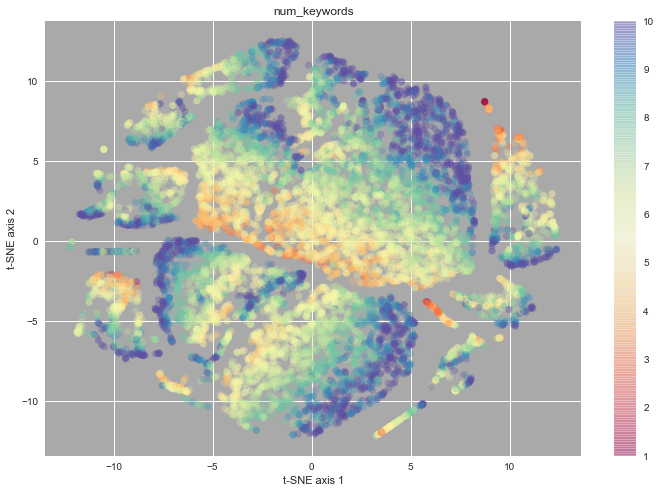

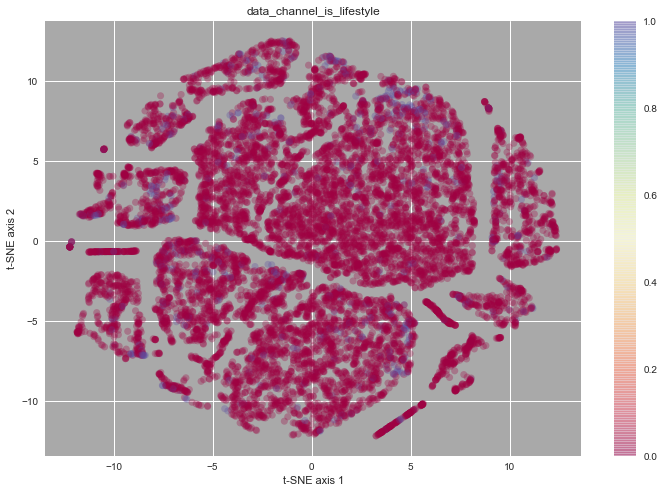

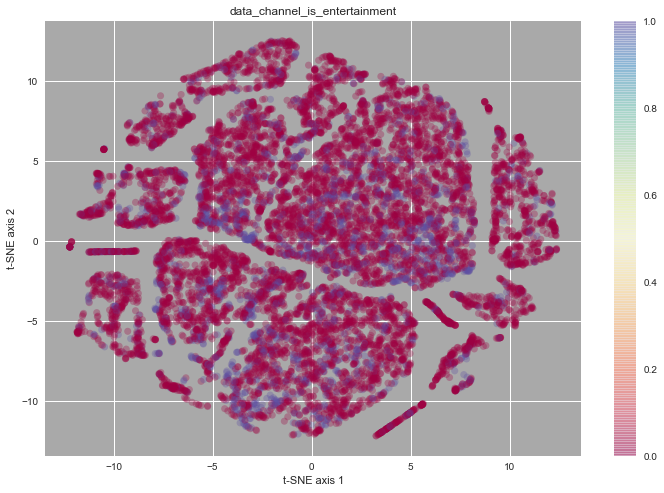

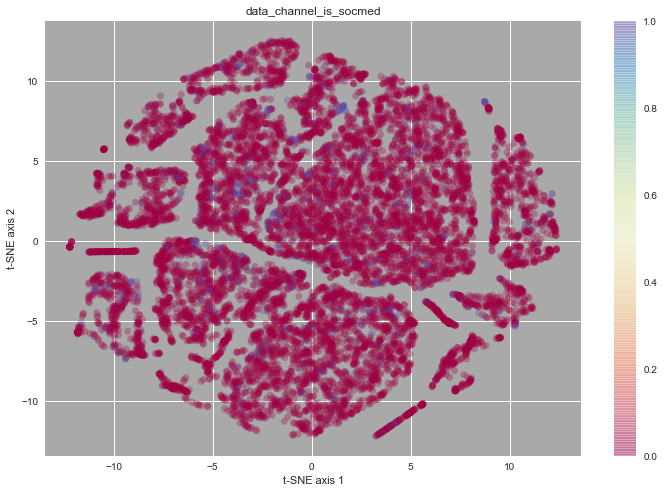

...

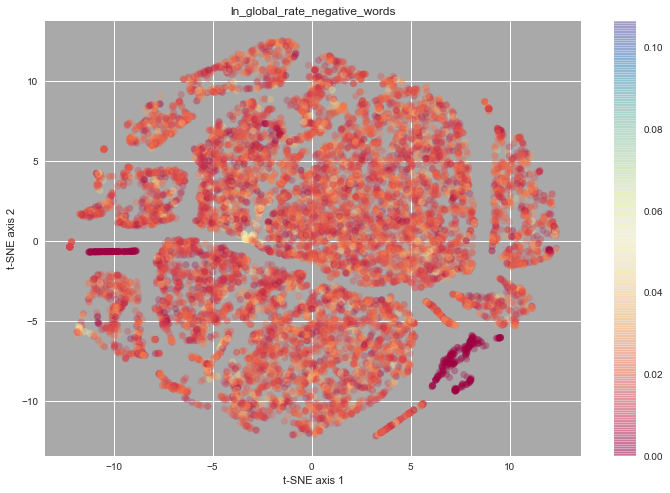

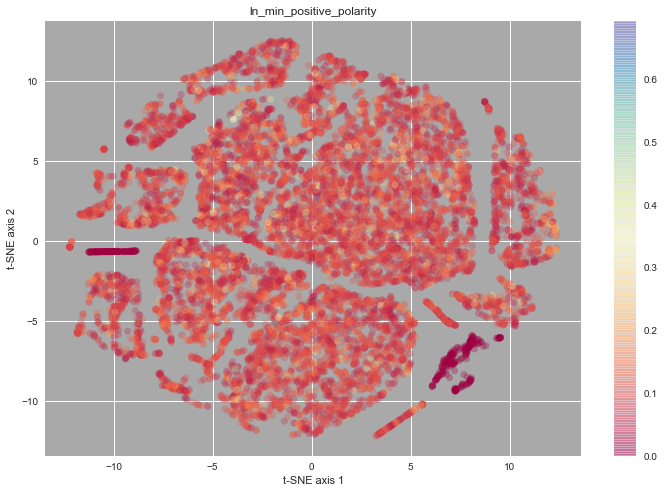

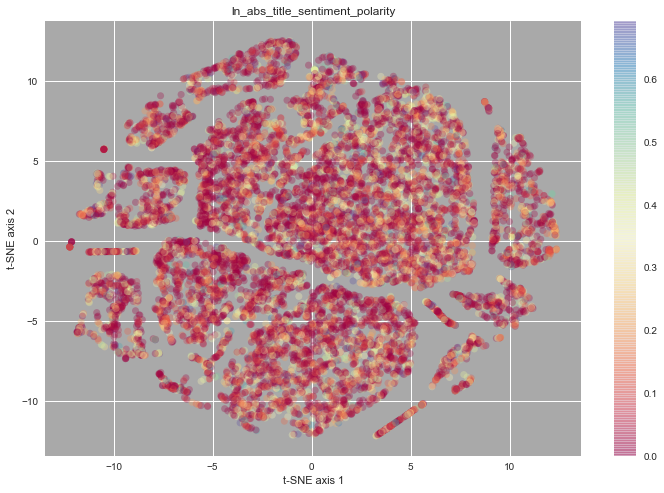

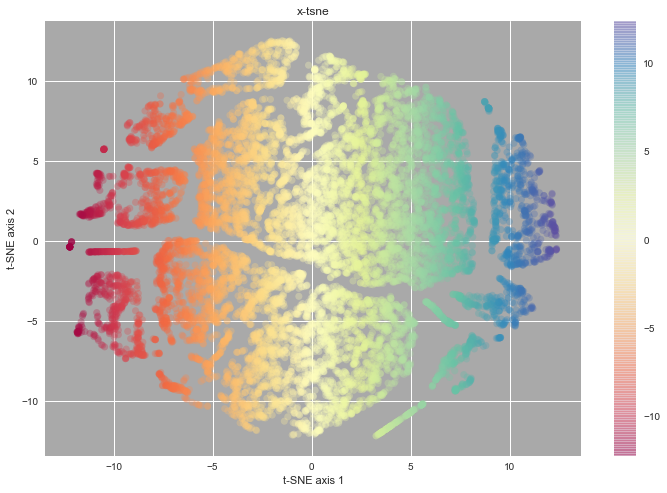

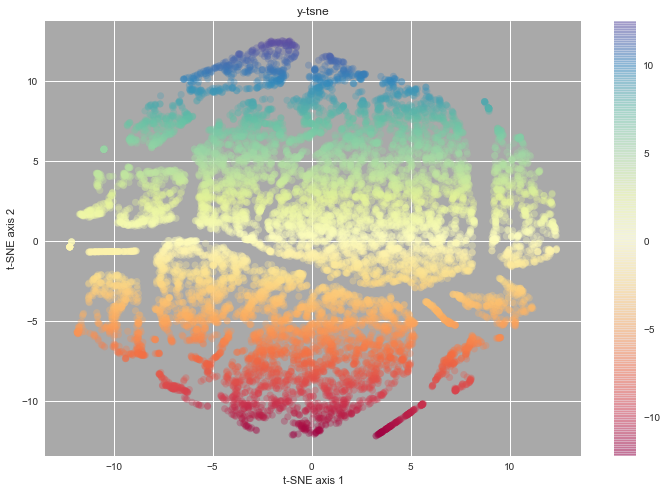

In [67]:
from ggplot import *
from ggplot import scale_fill_brewer
from matplotlib import cm

df_tsne = copy.deepcopy(X1)
df_tsne['x-tsne'] = tsne_results[:,0]
df_tsne['y-tsne'] = tsne_results[:,1]

col_names = df_tsne.columns.values.tolist()

for col in col_names :
    plt.figure(figsize=(12, 8));
    plt.subplot(111, axisbg='darkgrey');
    plt.scatter(df_tsne['x-tsne'], df_tsne['y-tsne'],
                 c = df_tsne[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    plt.colorbar()
    plt.xlabel('t-SNE axis 1')
    plt.ylabel('t-SNE axis 2')
    plt.title(col)
    plt.grid(True)
    plt.show();


In [48]:
tsne_results
len(tsne_results)

array([[  3.44641972,  -6.01625061],
       [ -7.65256214,  -4.43160725],
       [  0.46993127,   0.86966801],
       ..., 
       [ -2.87863922,   7.63277388],
       [  1.98842239,   6.56376886],
       [ -1.59004664, -10.48487186]], dtype=float32)

11893

In [59]:
# set required variables for model comparison

tsne_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []




### Spectral Clustering on the t-SNE 2-D mapping  



n_clusters =  2


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:234: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

silhouette =  0.20519


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


n_clusters = 2


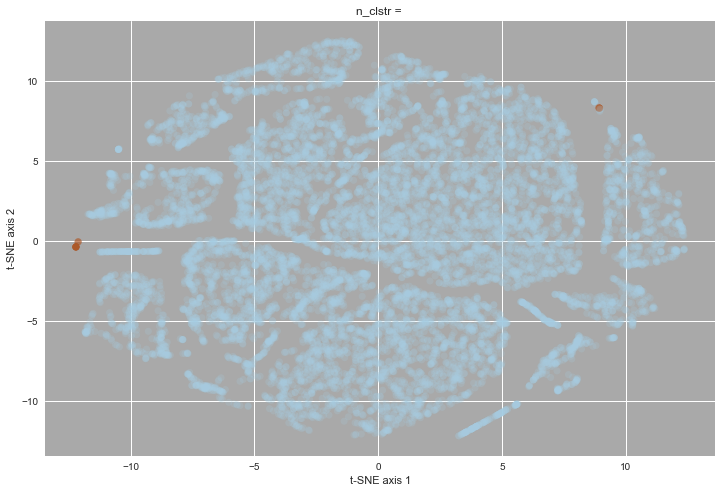

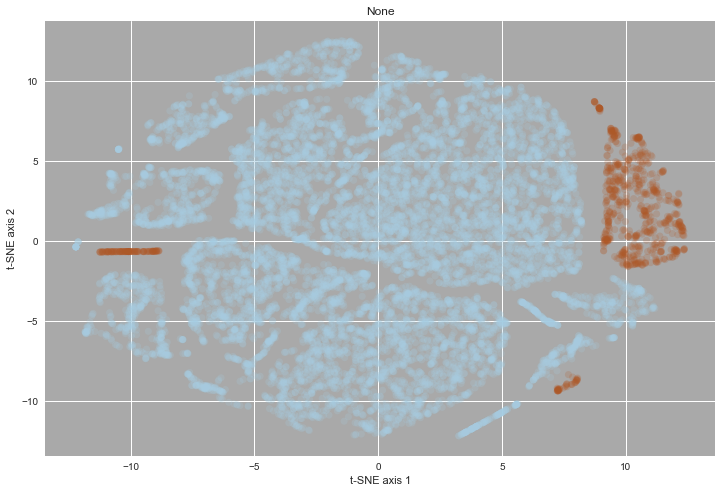

n_clusters =  3


array([1, 1, 0, ..., 0, 0, 1], dtype=int32)

silhouette =  0.145513


n_clusters = 3


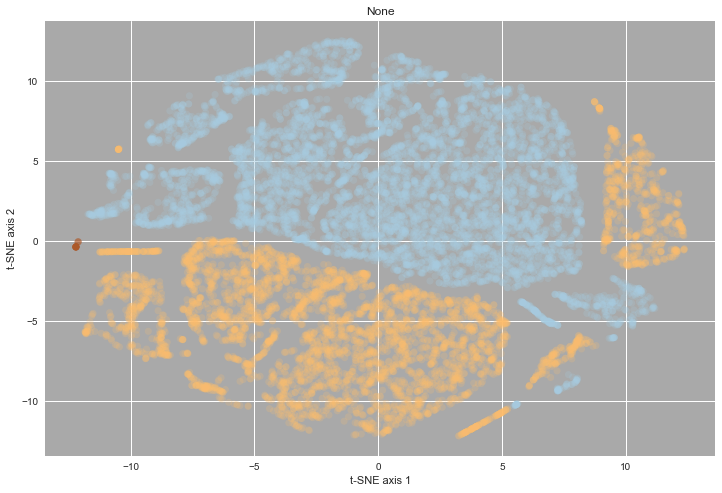

n_clusters =  4


array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

silhouette =  0.00557496


n_clusters = 4


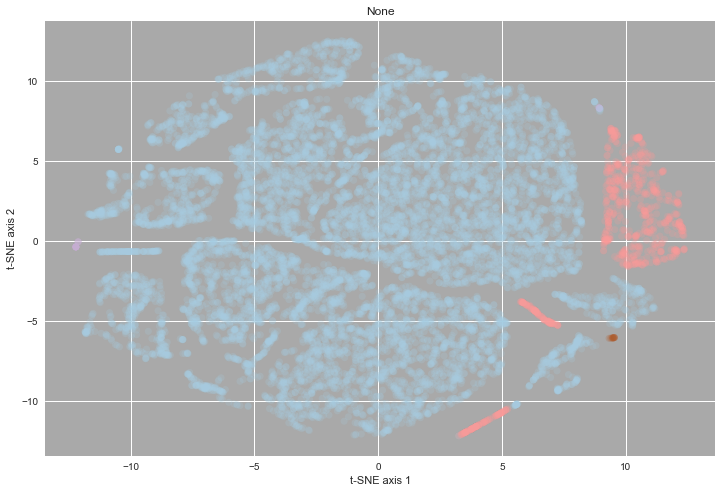

n_clusters =  5


array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

silhouette =  -0.19882


n_clusters = 5


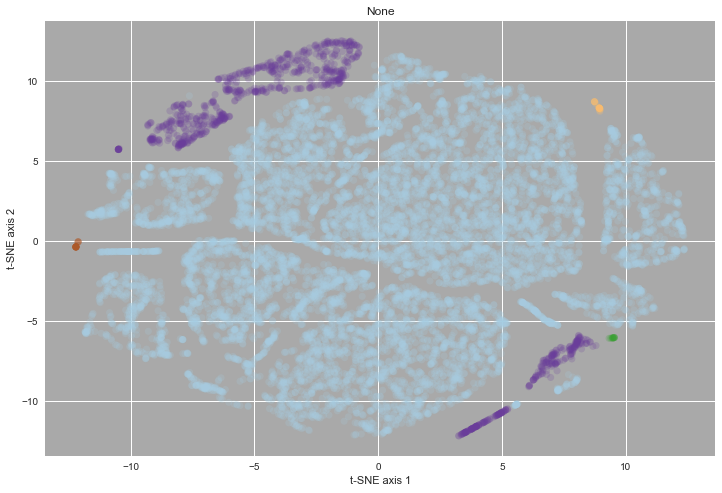

n_clusters =  6


array([1, 0, 1, ..., 5, 1, 1], dtype=int32)

silhouette =  -0.220689


n_clusters = 6


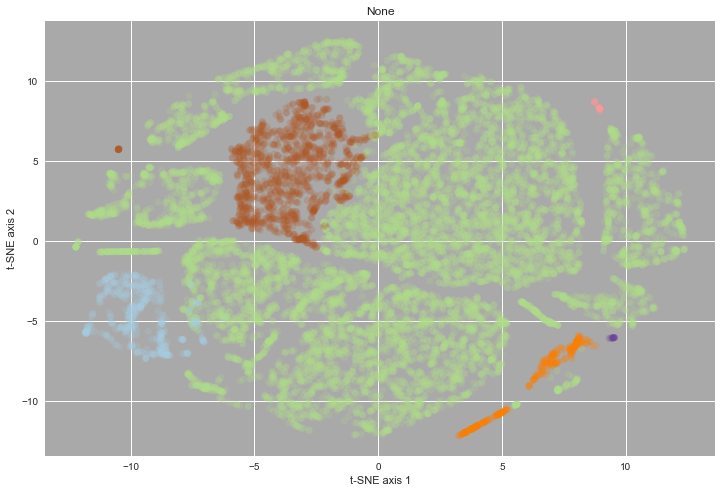

n_clusters =  7


array([0, 2, 0, ..., 0, 0, 0], dtype=int32)

silhouette =  -0.2278


n_clusters = 7


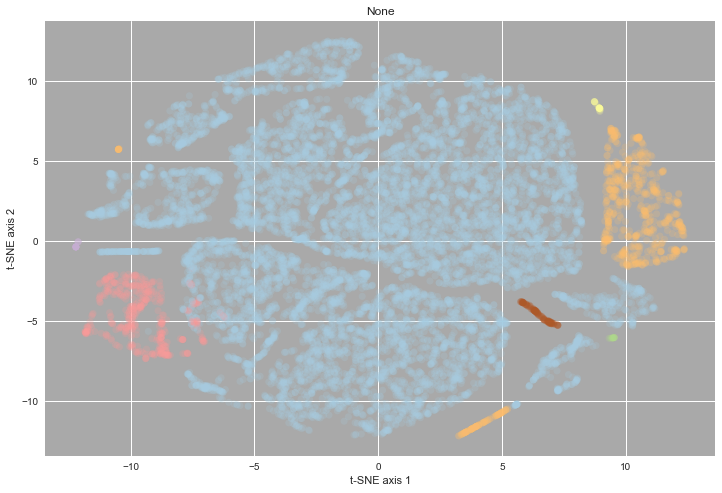

n_clusters =  8


array([7, 0, 1, ..., 6, 1, 7], dtype=int32)

silhouette =  -0.018651


n_clusters = 8


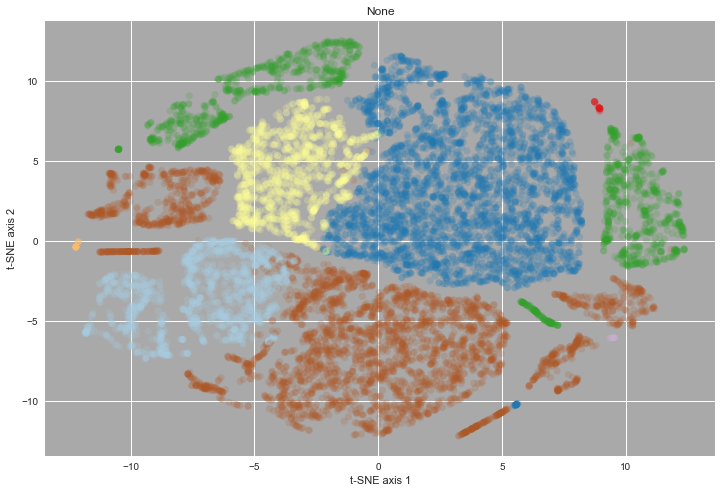

n_clusters =  9


array([8, 6, 1, ..., 0, 1, 8], dtype=int32)

silhouette =  -0.028307


n_clusters = 9


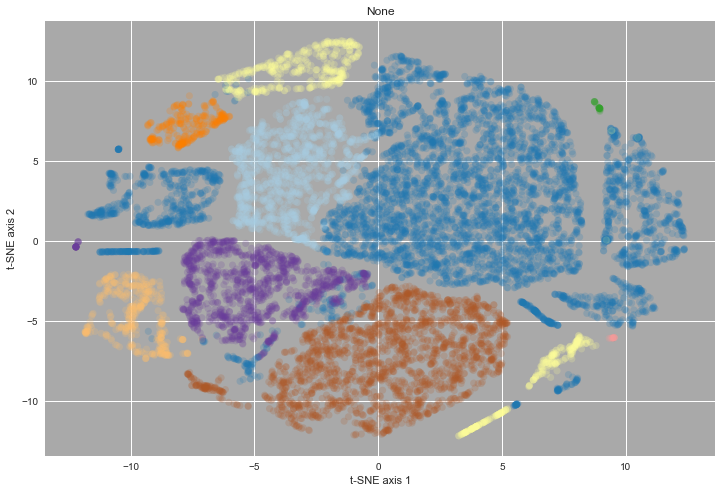

In [64]:
# ... spectraclustering on the t-sne vectors

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = tsne_results[:,0]
X_tsne['t2'] = tsne_results[:,1]

from sklearn.cluster import SpectralClustering

# If a string, this may be one of 
#  ‘nearest_neighbors’, ‘precomputed’, ‘rbf’ 
#  or one of the kernels supported by sklearn.metrics.pairwise_kernels

for n_clstr in range(2, 10):   

    tic = time.clock()
    
    print ("n_clusters = ", n_clstr)

    spc = SpectralClustering(n_clusters = n_clstr,
                             affinity = 'nearest_neighbors')
    spc_labels = spc.fit_predict(X_tsne) 
    spc_labels
    spc_silhouette = metrics.silhouette_score(X_tsne,
                                                 spc_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", spc_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'spc - features',
    'n_clusters' : n_clstr,
    'inertia': 0,
    'silhouette': spc_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    tsne_tbl = tsne_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize=(12, 8));
    plt.subplot(111, axisbg='darkgrey');
    
    X_tsne_values = X_tsne.values;
    plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = spc_labels,
                cmap = plt.cm.Paired,
                s = 50,
                linewidths = 0,
                alpha = 0.20);    
    
    plt.xlabel('t-SNE axis 1')
    plt.ylabel('t-SNE axis 2')
    title = print('n_clusters =', n_clstr);
    plt.title('title')
    plt.grid(True);

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - 
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-



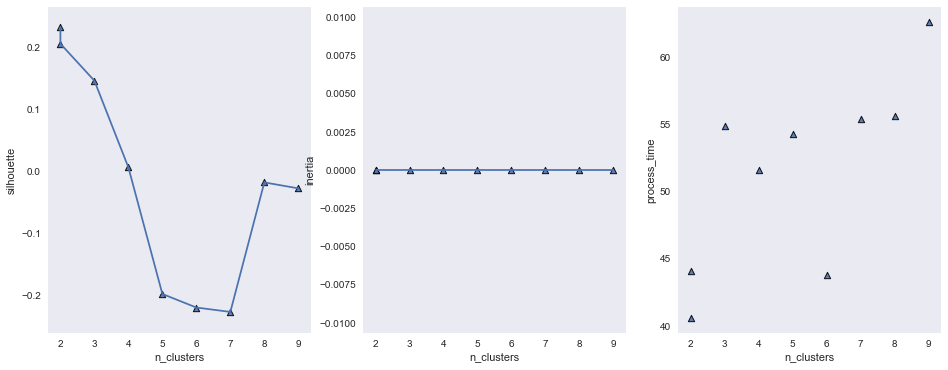

In [65]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(131);
plt.scatter(tsne_tbl['n_clusters'],
            tsne_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(tsne_tbl['n_clusters'],
         tsne_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.grid();

# ... inertia values

plt.subplot(132);
plt.scatter(tsne_tbl['n_clusters'],
            tsne_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(tsne_tbl['n_clusters'],
         tsne_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.grid();

# ... process time

plt.subplot(133);
plt.scatter(tsne_tbl['n_clusters'],
            tsne_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(tsne_tbl['n_clusters'],
#         tsne_tbl['process_time'])

plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.grid();


plt.show();


### - choose spectral clustering with preferred number of clusters  


n_clusters =  8


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:234: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


array([1, 7, 1, ..., 0, 1, 1], dtype=int32)

silhouette =  -0.238869


(<matplotlib.text.Text at 0x7fe799513ac8>,
 <matplotlib.text.Text at 0x7fe799bc1898>)

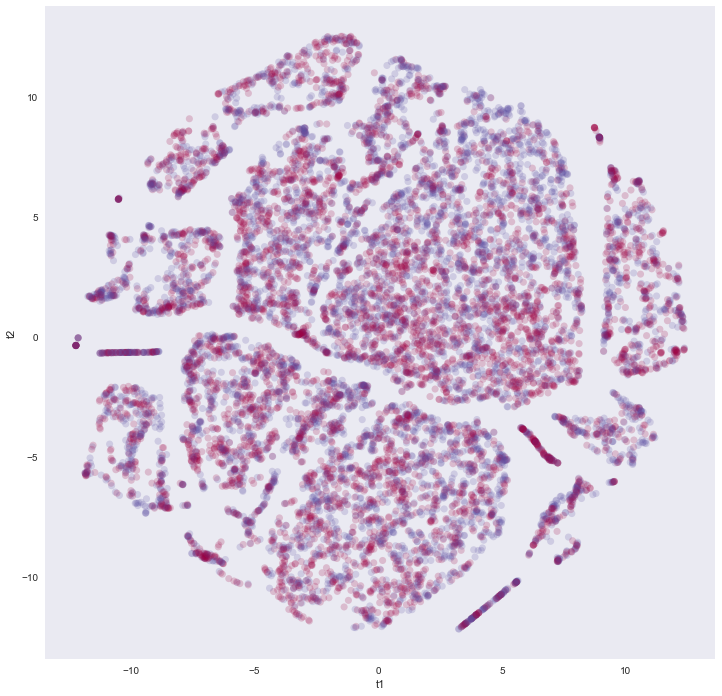

In [66]:

n_clusters_chosen = 8

for n_clstr in range(n_clusters_chosen, n_clusters_chosen+1):   

    tic = time.clock()
    
    print ("n_clusters = ", n_clstr)

    spc = SpectralClustering(n_clusters = n_clstr,
                             affinity = 'nearest_neighbors')
    spc_labels = spc.fit_predict(X_tsne) 
    spc_labels
    spc_silhouette = metrics.silhouette_score(X_tsne,
                                                 spc_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", spc_silhouette)
    
    toc =  time.clock()



In [68]:

X_all_together = copy.deepcopy(X1)

len(X_all_together)

X_all_together['ln_shares'] = X1_ln_shares
X_all_together['popular'] = X1_popular
X_all_together['spc_labels'] = spc_labels

X_all_together['t1'] = tsne_results[:,0]
X_all_together['t2'] = tsne_results[:,1]


11893

,count,mean,std,min,25%,50%,75%,max
n_tokens_title,11893.0,10.376776,2.100059,2.000000,9.000000,10.000000,12.000000,19.000000
num_keywords,11893.0,7.235349,1.909407,1.000000,6.000000,7.000000,9.000000,10.000000
data_channel_is_lifestyle,11893.0,0.052888,0.223820,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_entertainment,11893.0,0.175481,0.380394,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_socmed,11893.0,0.057765,0.233308,0.000000,0.000000,0.000000,0.000000,1.000000
kw_avg_max,11893.0,1.925615,0.995841,0.004170,1.282797,1.812397,2.459173,6.248298
weekday_is_monday,11893.0,0.169091,0.374848,0.000000,0.000000,0.000000,0.000000,1.000000
weekday_is_tuesday,11893.0,0.183217,0.386861,0.000000,0.000000,0.000000,0.000000,1.000000
weekday_is_wednesday,11893.0,0.185319,0.388573,0.000000,0.000000,0.000000,0.000000,1.000000
weekday_is_thursday,11893.0,0.183385,0.386998,0.000000,0.000000,0.000000,0.000000,1.000000


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


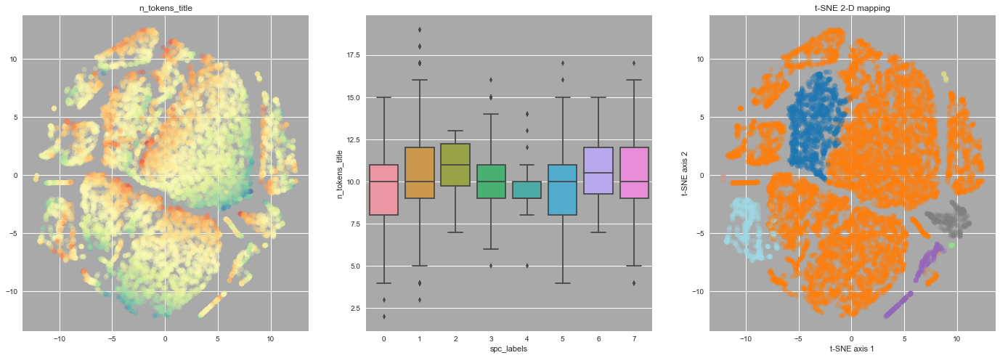

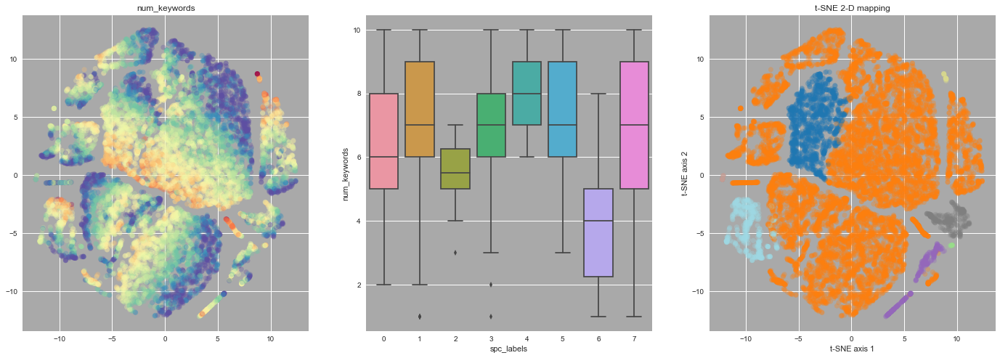

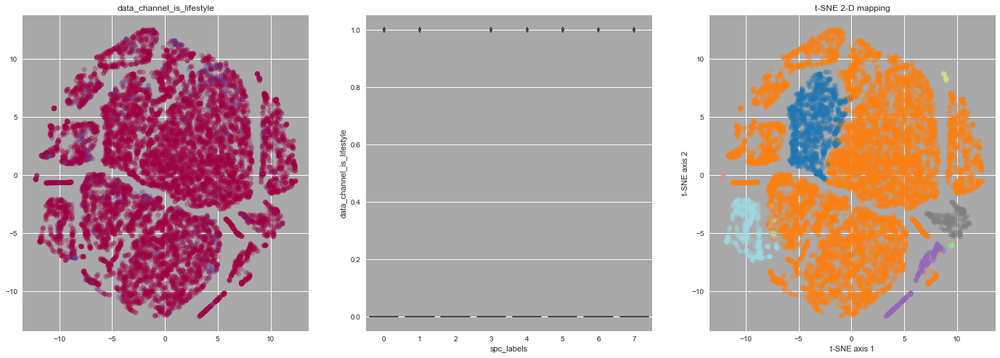

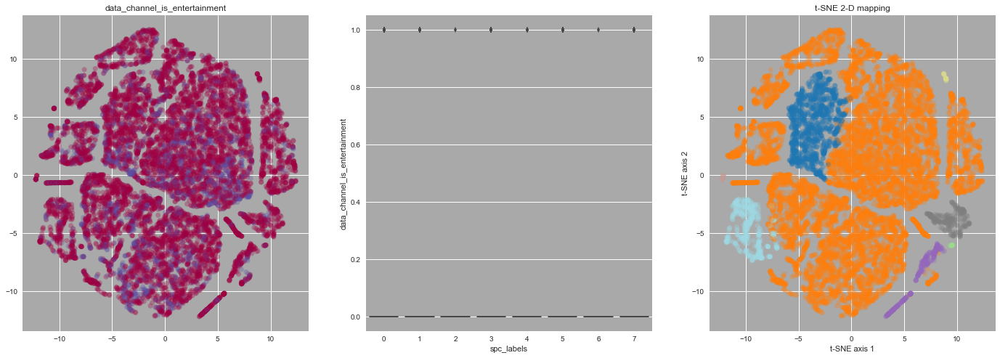

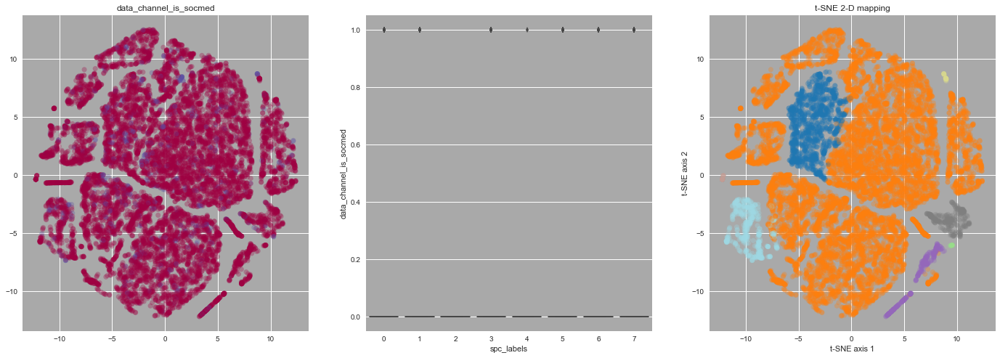

...

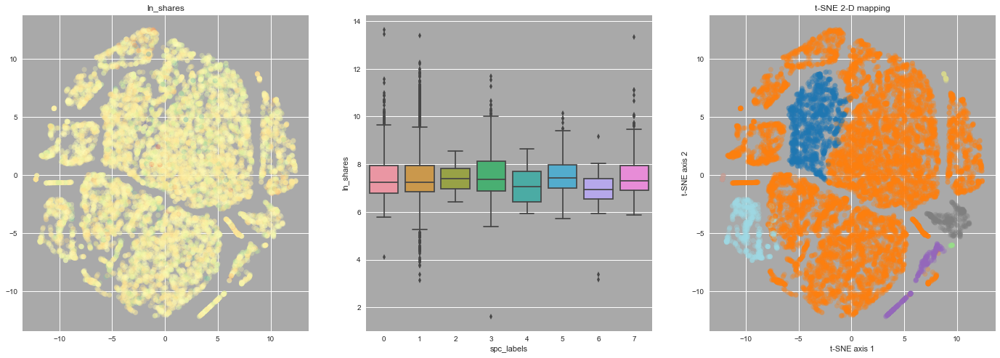

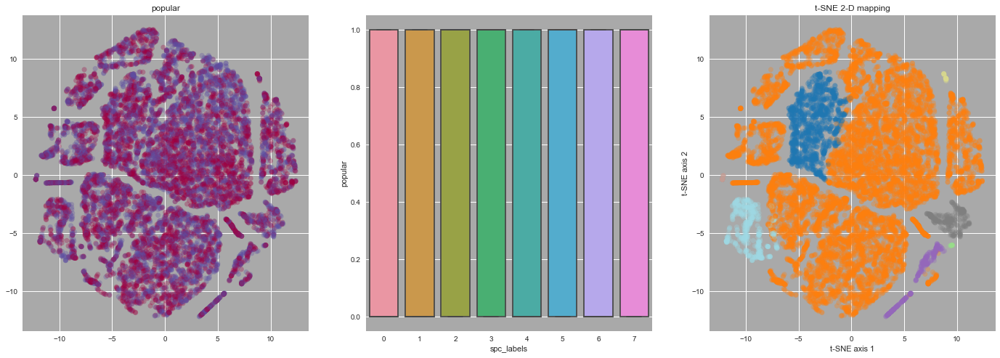

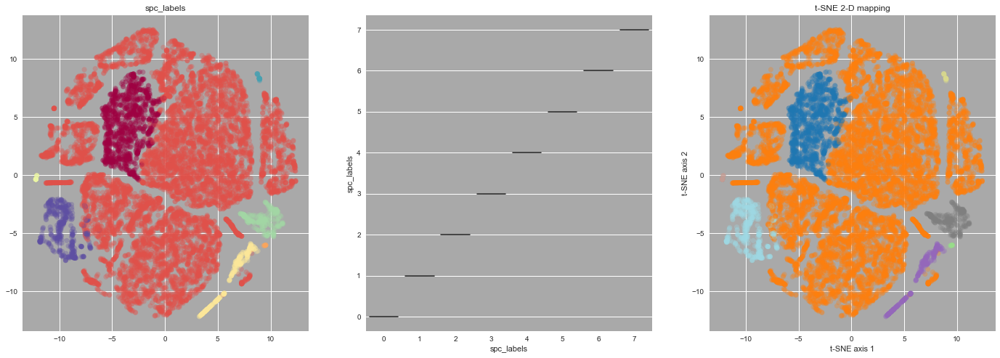

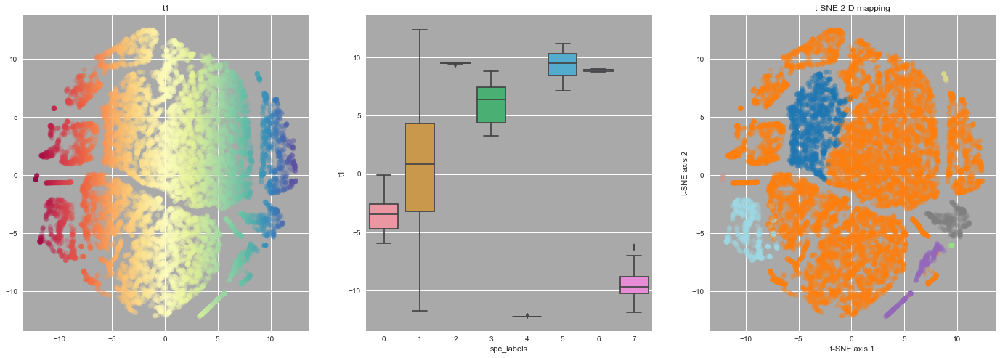

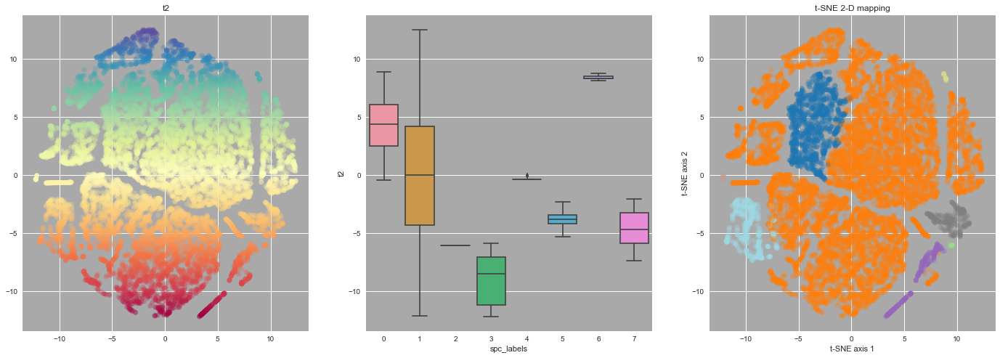

In [74]:
# boxplot across clusters for each feature ...
import seaborn as sns


col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    
# ... feature distribution color map 

    _ = plt.subplot(131, axisbg='darkgrey');
    
    _ = plt.scatter(X_all_together['t1'], X_all_together['t2'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132, axisbg='darkgrey');
    sns.boxplot(x = "spc_labels", y = col, data = X_all_together);

# ... cluster color map
    
    _ = plt.subplot(133, axisbg='darkgrey');
    
    _ = plt.scatter(X_all_together['t1'], X_all_together['t2'],
                 c = spc_labels,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
 
    plt.show();
    

<a href='#toc'> Table of Contents</a>

<a name='end_of_file'></a>
<font color="blue" size=3>  end of file

In [76]:
X1_ln_shares.describe().T

count    11893.000000
mean         7.478168
std          0.941855
min          1.609438
25%          6.846943
50%          7.244942
75%          7.937732
max         13.645079
Name: ln_shares, dtype: float64

In [79]:
np.exp(7)

1096.6331584284585